# Dataset Preparation

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [1]:
!unzip C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/img_align_celeba.zip -d C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA

'unzip' is not recognized as an internal or external command,
operable program or batch file.


In [2]:
import os
import pandas as pd
from PIL import Image
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import shutil

# Paths
img_dir = 'C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/img_align_celeba/img_align_celeba'
attr_file = 'C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/list_attr_celeba.txt'
eval_file = 'C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/list_eval_partition.txt'

# New folder for reduced dataset
reduced_dir = 'C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/ReducedCelebA/img_align_celeba'
reduced_attr_file = 'C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/ReducedCelebA/list_attr_celeba.txt'
reduced_eval_file = 'C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/ReducedCelebA/list_eval_partition.txt'

# Create the reduced dataset directory
os.makedirs(reduced_dir, exist_ok=True)

print(f"Number of images in directory: {len(os.listdir(img_dir))}")

# List of available image files in the directory
available_images = set(os.listdir(img_dir))  # Convert to a set for fast lookup

# Load attributes
attributes = pd.read_csv(attr_file, delim_whitespace=True, skiprows=1)
attributes.reset_index(inplace=True)  # Reset index to make image IDs a column

# Load evaluation splits
partitions = pd.read_csv(eval_file, delim_whitespace=True, header=None, names=['image_id', 'partition'])

# Filter attributes and partitions to only include available images
attributes = attributes[attributes['index'].isin(available_images)]
partitions = partitions[partitions['image_id'].isin(available_images)]

# Merge attributes and partitions
data = pd.merge(attributes, partitions, left_on='index', right_on='image_id')

# Drop unnecessary columns
data.drop(columns=['index'], inplace=True)

print(f"Number of available images in img_dir: {len(available_images)}")
print(f"Filtered Data shape: {data.shape}")

# **Reduce dataset to 50%**
data = data.sample(frac=0.5, random_state=42).reset_index(drop=True)  # Randomly sample 50% of the data
print(f"Reduced Data shape: {data.shape}")

# Save reduced images to the new folder
for img_id in data['image_id']:
    src_path = os.path.join(img_dir, img_id)
    dst_path = os.path.join(reduced_dir, img_id)
    if os.path.exists(src_path):  # Ensure the source file exists
        shutil.copy(src_path, dst_path)

# Save the reduced attributes and evaluation splits
data.iloc[:, :-1].to_csv(reduced_attr_file, sep=' ', index=False)  # Save attributes
data[['image_id', 'partition']].to_csv(reduced_eval_file, sep=' ', index=False, header=False)  # Save partitions

print(f"Reduced dataset saved to: {reduced_dir}")
print(f"Reduced attributes file saved to: {reduced_attr_file}")
print(f"Reduced evaluation file saved to: {reduced_eval_file}")

# Splitting Data
train_data, temp_data = train_test_split(data, test_size=0.2, random_state=42)  # 80% training
val_data, test_data = train_test_split(temp_data, test_size=0.5, random_state=42)  # Split remaining 20% equally

# Transformations: Resize, ToTensor, Normalize
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),  # Converts [0, 255] to [0.0, 1.0]
    transforms.Normalize(mean=[0.5], std=[0.5])  # Normalize to [-1, 1]
])

# Custom Dataset Class
class CelebADataset(Dataset):
    def __init__(self, img_dir, data, transform=None):
        self.img_dir = img_dir
        self.data = data
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_id = self.data.iloc[idx]['image_id']
        img_path = os.path.join(self.img_dir, img_id)
        img = Image.open(img_path).convert('RGB')  # Ensure 3 channels
        if self.transform:
            img = self.transform(img)
        return img  # Return image

# Create Dataset Objects
train_dataset = CelebADataset(reduced_dir, train_data, transform)
val_dataset = CelebADataset(reduced_dir, val_data, transform)
test_dataset = CelebADataset(reduced_dir, test_data, transform)

# DataLoaders
train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=128, shuffle=False)

# Check Data Splits
print(f"Training samples: {len(train_dataset)}")
print(f"Validation samples: {len(val_dataset)}")
print(f"Testing samples: {len(test_dataset)}")


Number of images in directory: 202599


C:\Users\HP\AppData\Local\Temp\ipykernel_93244\2510451093.py:28: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  attributes = pd.read_csv(attr_file, delim_whitespace=True, skiprows=1)
C:\Users\HP\AppData\Local\Temp\ipykernel_93244\2510451093.py:32: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  partitions = pd.read_csv(eval_file, delim_whitespace=True, header=None, names=['image_id', 'partition'])


Number of available images in img_dir: 202599
Filtered Data shape: (202599, 42)
Reduced Data shape: (101300, 42)
Reduced dataset saved to: C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/ReducedCelebA/img_align_celeba
Reduced attributes file saved to: C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/ReducedCelebA/list_attr_celeba.txt
Reduced evaluation file saved to: C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/ReducedCelebA/list_eval_partition.txt
Training samples: 81040
Validation samples: 10130
Testing samples: 10130


In [3]:
print(f"Number of reduced images: {len(os.listdir(reduced_dir))}")
reduced_attributes = pd.read_csv(reduced_attr_file, delim_whitespace=True)
reduced_partitions = pd.read_csv(reduced_eval_file, delim_whitespace=True, header=None)
print(f"Reduced attributes shape: {reduced_attributes.shape}")
print(f"Reduced partitions shape: {reduced_partitions.shape}")

Number of reduced images: 101300


C:\Users\HP\AppData\Local\Temp\ipykernel_93244\1003306192.py:2: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  reduced_attributes = pd.read_csv(reduced_attr_file, delim_whitespace=True)


Reduced attributes shape: (101300, 41)
Reduced partitions shape: (101300, 2)


C:\Users\HP\AppData\Local\Temp\ipykernel_93244\1003306192.py:3: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  reduced_partitions = pd.read_csv(reduced_eval_file, delim_whitespace=True, header=None)


In [6]:
# New folder for reduced dataset
img_dir = 'C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/ReducedCelebA/img_align_celeba/'
attr_file = 'C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/ReducedCelebA/list_attr_celeba.txt'
eval_file = 'C:/Users/HP/OneDrive - Higher Education Commission/Desktop/Adv ML/PA5/CelebA/ReducedCelebA/list_eval_partition.txt'

In [ ]:
# import pandas as pd

# # Load attributes
# attributes = pd.read_csv(attr_file, delim_whitespace=True, skiprows=1)

# # Load evaluation splits
# partitions = pd.read_csv(eval_file, delim_whitespace=True, header=None, names=['image_id', 'partition'])


<ipython-input-5-5bf49638a3c5>:4: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  attributes = pd.read_csv(attr_file, delim_whitespace=True, skiprows=1)
<ipython-input-5-5bf49638a3c5>:7: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  partitions = pd.read_csv(eval_file, delim_whitespace=True, header=None, names=['image_id', 'partition'])


In [ ]:
# Display the first few rows of attributes
# print(attributes.head())

            5_o_Clock_Shadow  Arched_Eyebrows  Attractive  Bags_Under_Eyes  \
000001.jpg                -1                1           1               -1   
000002.jpg                -1               -1          -1                1   
000003.jpg                -1               -1          -1               -1   
000004.jpg                -1               -1           1               -1   
000005.jpg                -1                1           1               -1   

            Bald  Bangs  Big_Lips  Big_Nose  Black_Hair  Blond_Hair  ...  \
000001.jpg    -1     -1        -1        -1          -1          -1  ...   
000002.jpg    -1     -1        -1         1          -1          -1  ...   
000003.jpg    -1     -1         1        -1          -1          -1  ...   
000004.jpg    -1     -1        -1        -1          -1          -1  ...   
000005.jpg    -1     -1         1        -1          -1          -1  ...   

            Sideburns  Smiling  Straight_Hair  Wavy_Hair  Wearing_Earrings

In [ ]:
# Display the first few rows of partitions
# print(partitions.head())

     image_id  partition
0  000001.jpg          0
1  000002.jpg          0
2  000003.jpg          0
3  000004.jpg          0
4  000005.jpg          0


In [ ]:
# # Reset the index of attributes DataFrame to make image IDs a column
# attributes.reset_index(inplace=True)

# # Merge using the 'index' (image_id) column
# data = pd.merge(attributes, partitions, left_on='index', right_on='image_id')

# # Drop duplicate columns (if any) and rename for consistency
# data.drop(columns=['index'], inplace=True)

# print(f"Data shape: {data.shape}")
# print(data.head())

Data shape: (202599, 42)
   5_o_Clock_Shadow  Arched_Eyebrows  Attractive  Bags_Under_Eyes  Bald  \
0                -1                1           1               -1    -1   
1                -1               -1          -1                1    -1   
2                -1               -1          -1               -1    -1   
3                -1               -1           1               -1    -1   
4                -1                1           1               -1    -1   

   Bangs  Big_Lips  Big_Nose  Black_Hair  Blond_Hair  ...  Straight_Hair  \
0     -1        -1        -1          -1          -1  ...              1   
1     -1        -1         1          -1          -1  ...             -1   
2     -1         1        -1          -1          -1  ...             -1   
3     -1        -1        -1          -1          -1  ...              1   
4     -1         1        -1          -1          -1  ...             -1   

   Wavy_Hair  Wearing_Earrings  Wearing_Hat  Wearing_Lipstick  \
0 

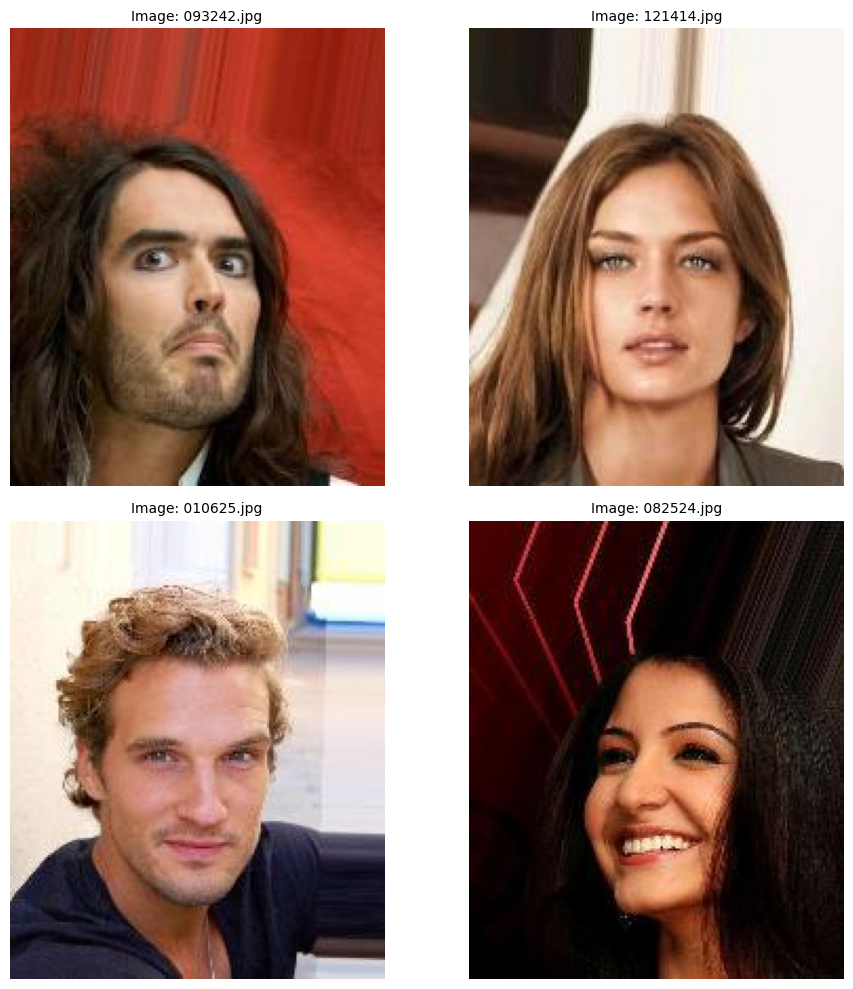

In [7]:
import matplotlib.pyplot as plt
from PIL import Image

# Get the first 4 image IDs
first_image_ids = list(data['image_id'][:4])

# Set up a 2x2 subplot
fig, axes = plt.subplots(2, 2, figsize=(10, 10))

for i, img_id in enumerate(first_image_ids):
    # Get image path
    img_path = img_dir + img_id
    try:
        img = Image.open(img_path)
        # Plot image
        ax = axes[i // 2, i % 2]  # Position in the subplot grid
        ax.imshow(img)
        ax.set_title(f"Image: {img_id}", fontsize=10)
        ax.axis('off')  # Hide axes for better visualization
    except FileNotFoundError:
        print(f"File not found: {img_path}")
        ax.set_title("Missing Image", fontsize=10)
        ax.axis('off')  # Ensure subplot still renders

# Adjust layout
plt.tight_layout()
plt.show()


# B-VAE Architecture

In [8]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class BetaVAE(nn.Module):
    def __init__(self, latent_dim=10):
        super(BetaVAE, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1),  # (64x64 -> 32x32)
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1),  # (32x32 -> 16x16)
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),  # (16x16 -> 8x8)
            nn.ReLU(),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),  # (8x8 -> 4x4)
            nn.ReLU(),
        )
        self.fc_mu = nn.Linear(256 * 4 * 4, latent_dim)  # Mean vector
        self.fc_logvar = nn.Linear(256 * 4 * 4, latent_dim)  # Log variance vector

        # Decoder
        self.decoder_input = nn.Linear(latent_dim, 256 * 4 * 4)
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # (4x4 -> 8x8)
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),  # (8x8 -> 16x16)
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),  # (16x16 -> 32x32)
            nn.ReLU(),
            nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1),  # (32x32 -> 64x64)
            nn.Tanh()  # Output range [-1, 1]
        )

    def encode(self, x):
        x = self.encoder(x).view(x.size(0), -1)
        mu = self.fc_mu(x)
        logvar = self.fc_logvar(x)
        return mu, logvar

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        z = self.decoder_input(z).view(z.size(0), 256, 4, 4)
        return self.decoder(z)

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        recon_x = self.decode(z)
        return recon_x, mu, logvar


# B-VAE Loss Function

In [9]:
import torch.nn.functional as F

def beta_vae_loss(recon_x, x, mu, logvar, beta=1.0):
    # Reconstruction Loss: MSE for normalized images in [-1, 1]
    recon_loss = F.mse_loss(recon_x, x, reduction='sum')  # Sum over all pixels

    # KL Divergence: Penalize deviation from N(0, I)
    kld_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    # Total Loss
    total_loss = recon_loss + beta * kld_loss
    return total_loss



In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = BetaVAE(latent_dim=10).to(device)

# Get a single batch
imgs = next(iter(train_loader)).to(device)

# Forward pass
recon_imgs, mu, logvar = model(imgs)

# Compute loss
loss = beta_vae_loss(recon_imgs, imgs, mu, logvar, beta=1.0)
print(f"Loss for single batch: {loss.item():.4f}")


Loss for single batch: 582415.9375


# Training the B-VAE

In [10]:
import torch
import torch.optim as optim
from tqdm import tqdm  # For progress bar

# Hyperparameters
latent_dim = 10
learning_rate = 1e-4
num_epochs = 3
beta_values = [1, 5, 10, 50]  # Test different β values

# Initialize model, optimizer
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = BetaVAE(latent_dim=latent_dim).to(device)
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Updated Training Function
def train_vae(model, train_loader, val_loader, beta):
    model.train()
    train_metrics = []  # Track metrics for Total Loss, KL Divergence, and Reconstruction Loss

    for epoch in range(num_epochs):
        epoch_loss = 0
        epoch_recon_loss = 0
        epoch_kl_loss = 0

        for imgs in tqdm(train_loader, desc=f"Training Epoch {epoch+1}/{num_epochs}, β={beta}"):
            imgs = imgs.to(device)

            # Forward pass
            recon_imgs, mu, logvar = model(imgs)

            # Compute losses
            recon_loss = F.mse_loss(recon_imgs, imgs, reduction='sum')  # Reconstruction loss
            kl_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())  # KL divergence
            total_loss = recon_loss + beta * kl_loss  # Total loss

            # Backward pass and optimization
            optimizer.zero_grad()
            total_loss.backward()
            optimizer.step()

            # Accumulate losses
            epoch_loss += total_loss.item()
            epoch_recon_loss += recon_loss.item()
            epoch_kl_loss += kl_loss.item()

        # Log average metrics for the epoch
        avg_total_loss = epoch_loss / len(train_loader.dataset)
        avg_recon_loss = epoch_recon_loss / len(train_loader.dataset)
        avg_kl_loss = epoch_kl_loss / len(train_loader.dataset)
        train_metrics.append((avg_total_loss, avg_recon_loss, avg_kl_loss))

        print(f"Epoch [{epoch+1}/{num_epochs}], Total Loss: {avg_total_loss:.4f}, "
              f"Reconstruction Loss: {avg_recon_loss:.4f}, KL Divergence: {avg_kl_loss:.4f}")

    return train_metrics

# Validation Function
def validate_vae(model, val_loader, beta):
    model.eval()
    val_loss = 0
    val_recon_loss = 0
    val_kl_loss = 0

    with torch.no_grad():
        for imgs in val_loader:
            imgs = imgs.to(device)
            recon_imgs, mu, logvar = model(imgs)

            # Compute losses
            recon_loss = F.mse_loss(recon_imgs, imgs, reduction='sum')  # Reconstruction loss
            kl_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())  # KL divergence
            total_loss = recon_loss + beta * kl_loss  # Total loss

            # Accumulate losses
            val_loss += total_loss.item()
            val_recon_loss += recon_loss.item()
            val_kl_loss += kl_loss.item()

    # Log average metrics for validation
    avg_val_loss = val_loss / len(val_loader.dataset)
    avg_val_recon_loss = val_recon_loss / len(val_loader.dataset)
    avg_val_kl_loss = val_kl_loss / len(val_loader.dataset)

    print(f"Validation - Total Loss: {avg_val_loss:.4f}, Reconstruction Loss: {avg_val_recon_loss:.4f}, "
          f"KL Divergence: {avg_val_kl_loss:.4f}")

    return avg_val_loss, avg_val_recon_loss, avg_val_kl_loss

# Train for each β value
results = {}
for beta in beta_values:
    print(f"\nTraining β-VAE with β={beta}")
    train_metrics = train_vae(model, train_loader, val_loader, beta)
    val_metrics = validate_vae(model, val_loader, beta)
    results[beta] = {"train_metrics": train_metrics, "val_metrics": val_metrics}

# Save the model
torch.save(model.state_dict(), "beta_vae_model.pth")



Training β-VAE with β=1


Training Epoch 1/3, β=1: 100%|██████████| 634/634 [05:58<00:00,  1.77it/s]


Epoch [1/3], Total Loss: 1779.4884, Reconstruction Loss: 1742.3479, KL Divergence: 37.1405


Training Epoch 2/3, β=1: 100%|██████████| 634/634 [06:09<00:00,  1.71it/s]


Epoch [2/3], Total Loss: 1194.7695, Reconstruction Loss: 1161.8528, KL Divergence: 32.9167


Training Epoch 3/3, β=1: 100%|██████████| 634/634 [06:14<00:00,  1.69it/s]


Epoch [3/3], Total Loss: 1159.0955, Reconstruction Loss: 1127.0194, KL Divergence: 32.0761
Validation - Total Loss: 1154.0552, Reconstruction Loss: 1122.0199, KL Divergence: 32.0354

Training β-VAE with β=5


Training Epoch 1/3, β=5: 100%|██████████| 634/634 [10:17<00:00,  1.03it/s]


Epoch [1/3], Total Loss: 1241.8303, Reconstruction Loss: 1126.0673, KL Divergence: 23.1526


Training Epoch 2/3, β=5: 100%|██████████| 634/634 [10:38<00:00,  1.01s/it]


Epoch [2/3], Total Loss: 1221.7699, Reconstruction Loss: 1107.6718, KL Divergence: 22.8196


Training Epoch 3/3, β=5: 100%|██████████| 634/634 [06:27<00:00,  1.64it/s]


Epoch [3/3], Total Loss: 1208.2135, Reconstruction Loss: 1094.4411, KL Divergence: 22.7545
Validation - Total Loss: 1207.6846, Reconstruction Loss: 1092.0552, KL Divergence: 23.1259

Training β-VAE with β=10


Training Epoch 1/3, β=10: 100%|██████████| 634/634 [05:22<00:00,  1.96it/s]


Epoch [1/3], Total Loss: 1302.6404, Reconstruction Loss: 1111.8687, KL Divergence: 19.0772


Training Epoch 2/3, β=10: 100%|██████████| 634/634 [05:22<00:00,  1.97it/s]


Epoch [2/3], Total Loss: 1293.8885, Reconstruction Loss: 1104.2427, KL Divergence: 18.9646


Training Epoch 3/3, β=10: 100%|██████████| 634/634 [05:20<00:00,  1.98it/s]


Epoch [3/3], Total Loss: 1287.0886, Reconstruction Loss: 1097.9879, KL Divergence: 18.9101
Validation - Total Loss: 1296.3962, Reconstruction Loss: 1105.2661, KL Divergence: 19.1130

Training β-VAE with β=50


Training Epoch 1/3, β=50: 100%|██████████| 634/634 [05:49<00:00,  1.81it/s]


Epoch [1/3], Total Loss: 1826.4564, Reconstruction Loss: 1312.7317, KL Divergence: 10.2745


Training Epoch 2/3, β=50: 100%|██████████| 634/634 [05:19<00:00,  1.98it/s]


Epoch [2/3], Total Loss: 1803.0017, Reconstruction Loss: 1312.3115, KL Divergence: 9.8138


Training Epoch 3/3, β=50: 100%|██████████| 634/634 [05:18<00:00,  1.99it/s]


Epoch [3/3], Total Loss: 1795.3319, Reconstruction Loss: 1309.7381, KL Divergence: 9.7119
Validation - Total Loss: 1796.6834, Reconstruction Loss: 1315.2448, KL Divergence: 9.6288


In [11]:
import pandas as pd

# Prepare the table
result_table = []
for beta, metrics in results.items():
    # Extract metrics for the last validation epoch
    val_total_loss, val_recon_loss, val_kl_loss = metrics['val_metrics']
    
    # Add a row for the table
    result_table.append({
        "Beta Value": beta,
        "Total Loss": val_total_loss,
        "KL Divergence": val_kl_loss,
        "Reconstruction Loss": val_recon_loss
    })

# Convert to a DataFrame
df = pd.DataFrame(result_table)

# Display the table
print(df.to_markdown(index=False))


|   Beta Value |   Total Loss |   KL Divergence |   Reconstruction Loss |
|-------------:|-------------:|----------------:|----------------------:|
|            1 |      1154.06 |        32.0354  |               1122.02 |
|            5 |      1207.68 |        23.1259  |               1092.06 |
|           10 |      1296.4  |        19.113   |               1105.27 |
|           50 |      1796.68 |         9.62877 |               1315.24 |


# Visualise Disentangled Latent factors

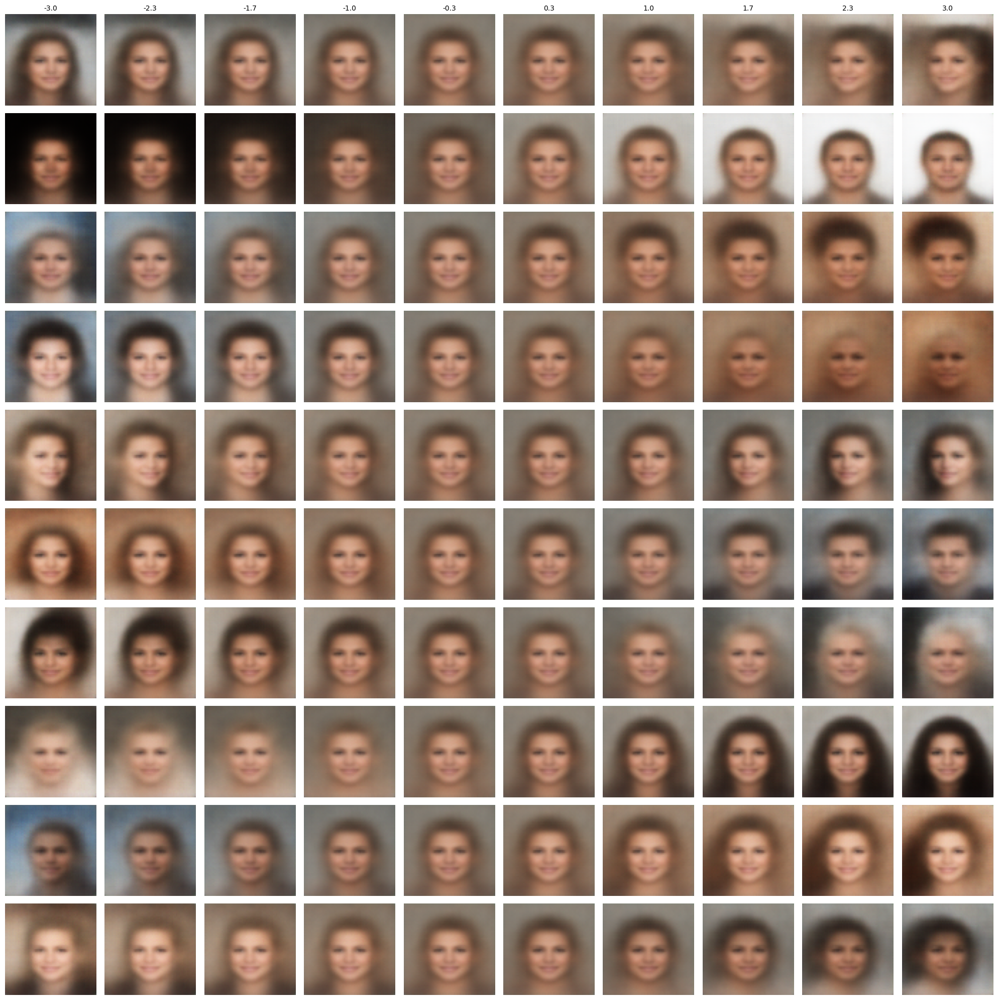

In [25]:
import matplotlib.pyplot as plt
import torch
import numpy as np

def visualize_disentangled_latent_factors(model, latent_dim, num_samples=10, variation_range=(-3, 3)):
    """
    Visualize disentangled latent factors by varying one latent dimension.

    Parameters:
    - model: Trained β-VAE model.
    - latent_dim: Number of latent dimensions in the model.
    - num_samples: Number of samples to generate per latent dimension.
    - variation_range: Range of values to vary for each latent dimension.
    """
    model.eval()
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    # Base latent vector (zeros)
    z_base = torch.zeros((1, latent_dim)).to(device)

    # Generate variation values
    variation_values = np.linspace(variation_range[0], variation_range[1], num_samples)

    # Setup the plot grid
    fig, axes = plt.subplots(latent_dim, num_samples, figsize=(num_samples * 2, latent_dim * 2))

    for dim in range(latent_dim):
        for i, value in enumerate(variation_values):
            z = z_base.clone()  # Start with the base vector
            z[0, dim] = value  # Vary only the current latent dimension

            # Decode to generate the image
            with torch.no_grad():
                generated_img = model.decode(z).squeeze(0).permute(1, 2, 0).cpu().numpy()
                generated_img = (generated_img * 0.5 + 0.5)  # Rescale to [0, 1]

            # Plot the generated image
            axes[dim, i].imshow(generated_img)
            axes[dim, i].axis("off")

            # Add column titles
            if dim == 0:
                axes[dim, i].set_title(f"{value:.1f}", fontsize=10)

        # Add row labels
        axes[dim, 0].set_ylabel(f"Latent Dim {dim+1}", fontsize=12)

    plt.tight_layout()
    plt.show()

# Parameters
latent_dim = 10  # As per your model
num_samples = 10  # Number of variations per latent dimension
variation_range = (-3, 3)  # Adjust this range if needed

# Visualize disentangled latent factors
visualize_disentangled_latent_factors(model, latent_dim=latent_dim, num_samples=num_samples, variation_range=variation_range)


#  Analysis of the correspondence between latent dimensions and interpretable GF of variation

In [26]:
import torch
import torch.optim as optim
from tqdm import tqdm  # For progress bar
import matplotlib.pyplot as plt
import numpy as np

# Hyperparameters
latent_dim = 10
learning_rate = 1e-4
num_epochs = 3
beta_values = [1, 5, 10, 50]  # Test different β values

# Initialize model, optimizer
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Updated Training Function
def train_vae(model, train_loader, val_loader, beta):
    model.train()
    train_metrics = []  # Track metrics for Total Loss, KL Divergence, and Reconstruction Loss

    for epoch in range(num_epochs):
        epoch_loss = 0
        epoch_recon_loss = 0
        epoch_kl_loss = 0

        for imgs in tqdm(train_loader, desc=f"Training Epoch {epoch+1}/{num_epochs}, β={beta}"):
            imgs = imgs.to(device)

            # Forward pass
            recon_imgs, mu, logvar = model(imgs)

            # Compute losses
            recon_loss = F.mse_loss(recon_imgs, imgs, reduction='sum')  # Reconstruction loss
            kl_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())  # KL divergence
            total_loss = recon_loss + beta * kl_loss  # Total loss

            # Backward pass and optimization
            optimizer.zero_grad()
            total_loss.backward()
            optimizer.step()

            # Accumulate losses
            epoch_loss += total_loss.item()
            epoch_recon_loss += recon_loss.item()
            epoch_kl_loss += kl_loss.item()

        # Log average metrics for the epoch
        avg_total_loss = epoch_loss / len(train_loader.dataset)
        avg_recon_loss = epoch_recon_loss / len(train_loader.dataset)
        avg_kl_loss = epoch_kl_loss / len(train_loader.dataset)
        train_metrics.append((avg_total_loss, avg_recon_loss, avg_kl_loss))

        print(f"Epoch [{epoch+1}/{num_epochs}], Total Loss: {avg_total_loss:.4f}, "
              f"Reconstruction Loss: {avg_recon_loss:.4f}, KL Divergence: {avg_kl_loss:.4f}")

    return train_metrics

# Validation Function
def validate_vae(model, val_loader, beta):
    model.eval()
    val_loss = 0
    val_recon_loss = 0
    val_kl_loss = 0

    with torch.no_grad():
        for imgs in val_loader:
            imgs = imgs.to(device)
            recon_imgs, mu, logvar = model(imgs)

            # Compute losses
            recon_loss = F.mse_loss(recon_imgs, imgs, reduction='sum')  # Reconstruction loss
            kl_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())  # KL divergence
            total_loss = recon_loss + beta * kl_loss  # Total loss

            # Accumulate losses
            val_loss += total_loss.item()
            val_recon_loss += recon_loss.item()
            val_kl_loss += kl_loss.item()

    # Log average metrics for validation
    avg_val_loss = val_loss / len(val_loader.dataset)
    avg_val_recon_loss = val_recon_loss / len(val_loader.dataset)
    avg_val_kl_loss = val_kl_loss / len(val_loader.dataset)

    print(f"Validation - Total Loss: {avg_val_loss:.4f}, Reconstruction Loss: {avg_val_recon_loss:.4f}, "
          f"KL Divergence: {avg_val_kl_loss:.4f}")

    return avg_val_loss, avg_val_recon_loss, avg_val_kl_loss

# Train for each β value and save models
results = {}
trained_models = {}

for beta in beta_values:
    print(f"\nTraining β-VAE with β={beta}")
    model = BetaVAE(latent_dim=latent_dim).to(device)
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    
    train_metrics = train_vae(model, train_loader, val_loader, beta)
    val_metrics = validate_vae(model, val_loader, beta)
    results[beta] = {"train_metrics": train_metrics, "val_metrics": val_metrics}
    
    # Save the trained model
    model_path = f"beta_vae_model_beta_{beta}.pth"
    torch.save(model.state_dict(), model_path)
    trained_models[beta] = model


Training β-VAE with β=1


Training Epoch 1/3, β=1: 100%|██████████| 634/634 [04:49<00:00,  2.19it/s]


Epoch [1/3], Total Loss: 1895.6969, Reconstruction Loss: 1857.8511, KL Divergence: 37.8458


Training Epoch 2/3, β=1: 100%|██████████| 634/634 [05:01<00:00,  2.11it/s]


Epoch [2/3], Total Loss: 1193.7444, Reconstruction Loss: 1159.7102, KL Divergence: 34.0342


Training Epoch 3/3, β=1: 100%|██████████| 634/634 [05:03<00:00,  2.09it/s]


Epoch [3/3], Total Loss: 1152.5807, Reconstruction Loss: 1119.9880, KL Divergence: 32.5927
Validation - Total Loss: 1145.6938, Reconstruction Loss: 1114.0979, KL Divergence: 31.5959

Training β-VAE with β=5


Training Epoch 1/3, β=5: 100%|██████████| 634/634 [05:04<00:00,  2.08it/s]


Epoch [1/3], Total Loss: 1902.1522, Reconstruction Loss: 1798.8597, KL Divergence: 20.6585


Training Epoch 2/3, β=5: 100%|██████████| 634/634 [05:01<00:00,  2.10it/s]


Epoch [2/3], Total Loss: 1294.6987, Reconstruction Loss: 1183.2341, KL Divergence: 22.2929


Training Epoch 3/3, β=5: 100%|██████████| 634/634 [04:58<00:00,  2.12it/s]


Epoch [3/3], Total Loss: 1258.2036, Reconstruction Loss: 1147.5206, KL Divergence: 22.1366
Validation - Total Loss: 1250.5298, Reconstruction Loss: 1140.3598, KL Divergence: 22.0340

Training β-VAE with β=10


Training Epoch 1/3, β=10: 100%|██████████| 634/634 [04:54<00:00,  2.15it/s]


Epoch [1/3], Total Loss: 2001.7526, Reconstruction Loss: 1846.8131, KL Divergence: 15.4940


Training Epoch 2/3, β=10: 100%|██████████| 634/634 [04:58<00:00,  2.13it/s]


Epoch [2/3], Total Loss: 1391.7276, Reconstruction Loss: 1212.0809, KL Divergence: 17.9647


Training Epoch 3/3, β=10: 100%|██████████| 634/634 [05:03<00:00,  2.09it/s]


Epoch [3/3], Total Loss: 1356.4941, Reconstruction Loss: 1175.8066, KL Divergence: 18.0688
Validation - Total Loss: 1347.1411, Reconstruction Loss: 1167.4274, KL Divergence: 17.9714

Training β-VAE with β=50


Training Epoch 1/3, β=50: 100%|██████████| 634/634 [05:10<00:00,  2.04it/s]


Epoch [1/3], Total Loss: 2483.0555, Reconstruction Loss: 2155.6818, KL Divergence: 6.5475


Training Epoch 2/3, β=50: 100%|██████████| 634/634 [08:04<00:00,  1.31it/s]


Epoch [2/3], Total Loss: 1881.8381, Reconstruction Loss: 1442.8850, KL Divergence: 8.7791


Training Epoch 3/3, β=50: 100%|██████████| 634/634 [06:41<00:00,  1.58it/s]


Epoch [3/3], Total Loss: 1849.8379, Reconstruction Loss: 1401.0355, KL Divergence: 8.9760
Validation - Total Loss: 1850.1093, Reconstruction Loss: 1405.3063, KL Divergence: 8.8961


Visualizing for β = 1


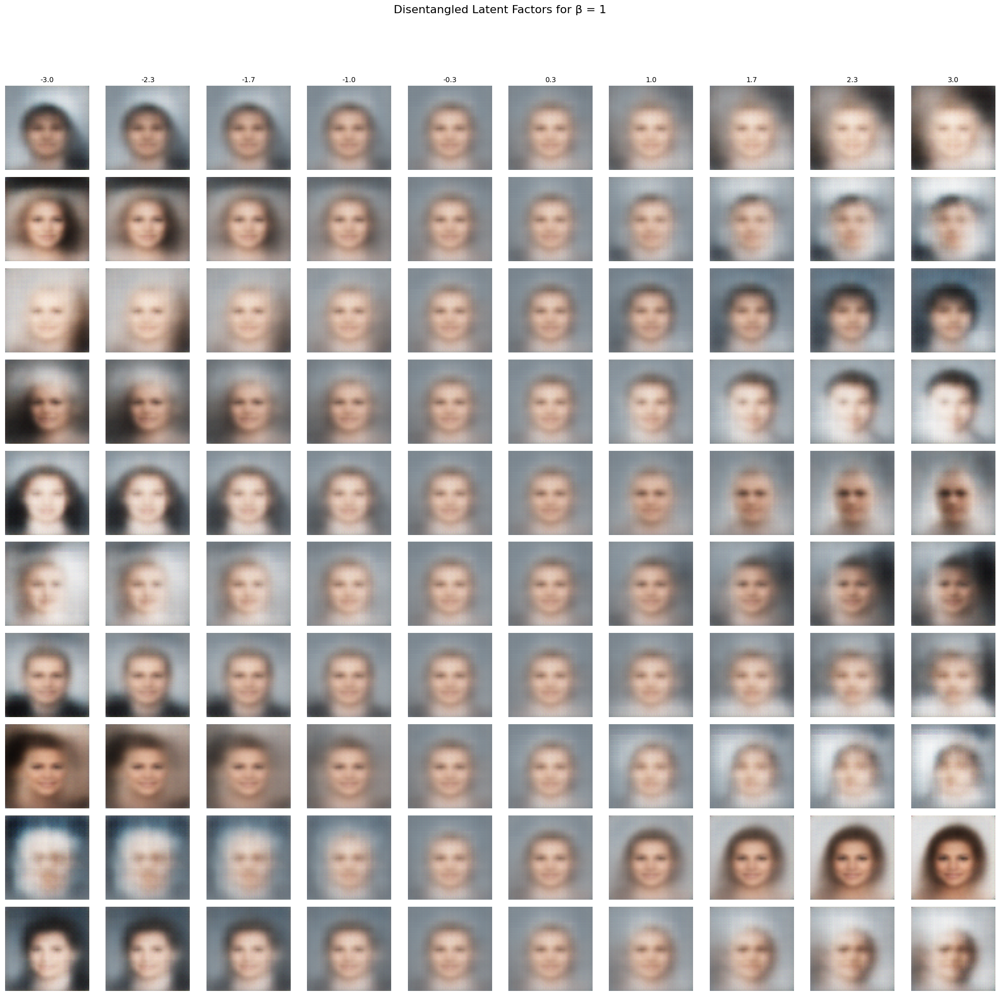

Visualizing for β = 5


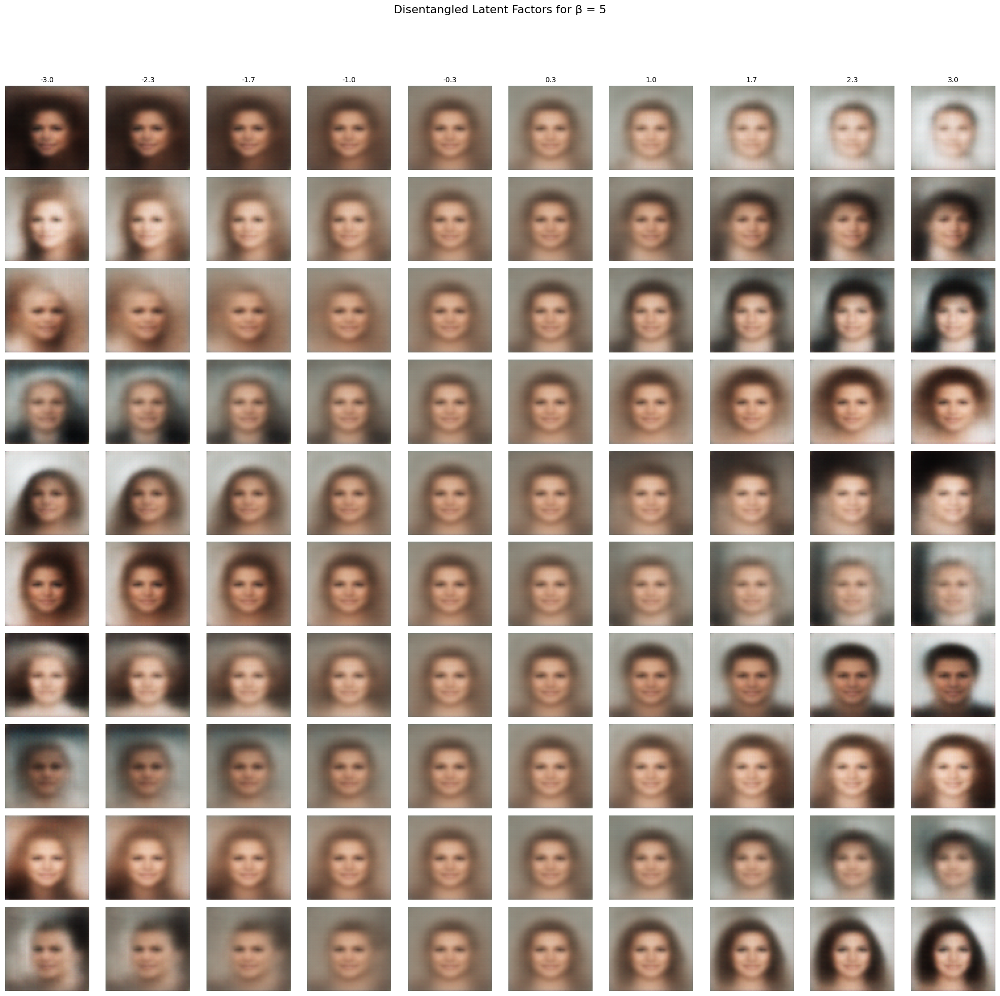

Visualizing for β = 10


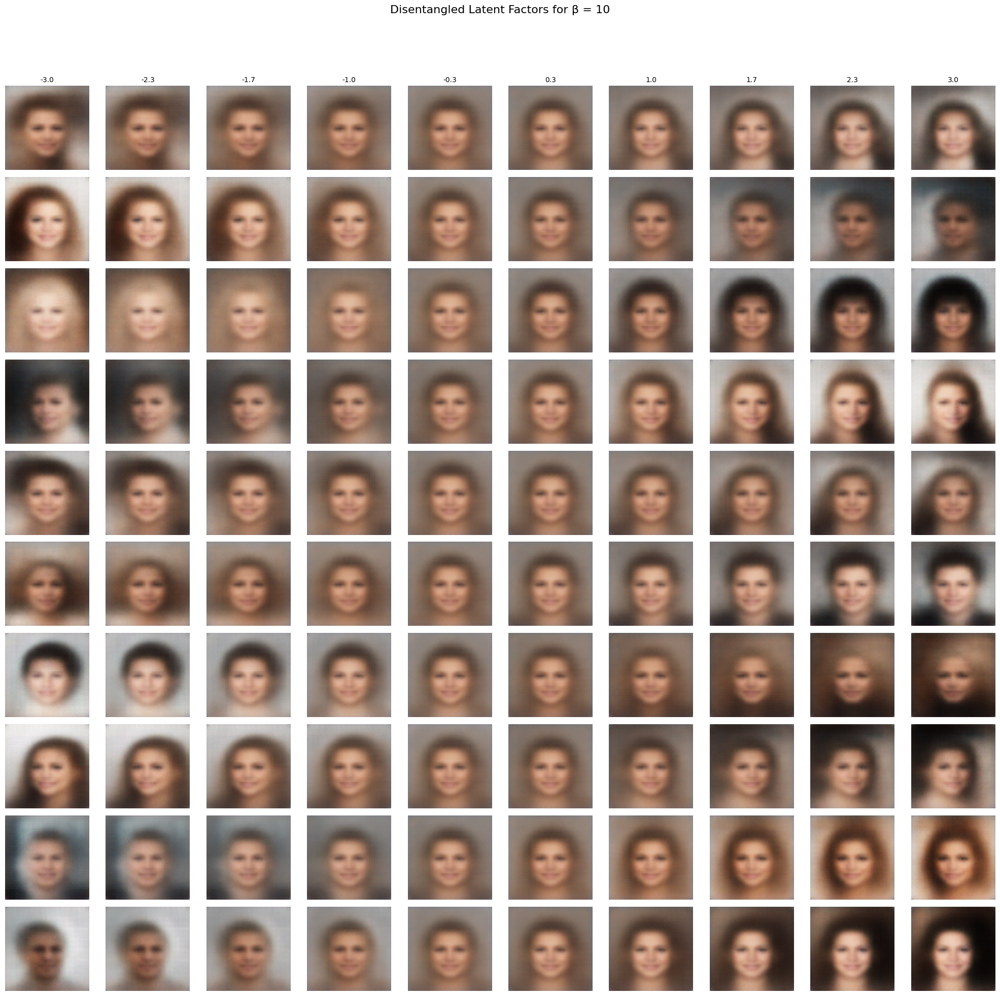

Visualizing for β = 50


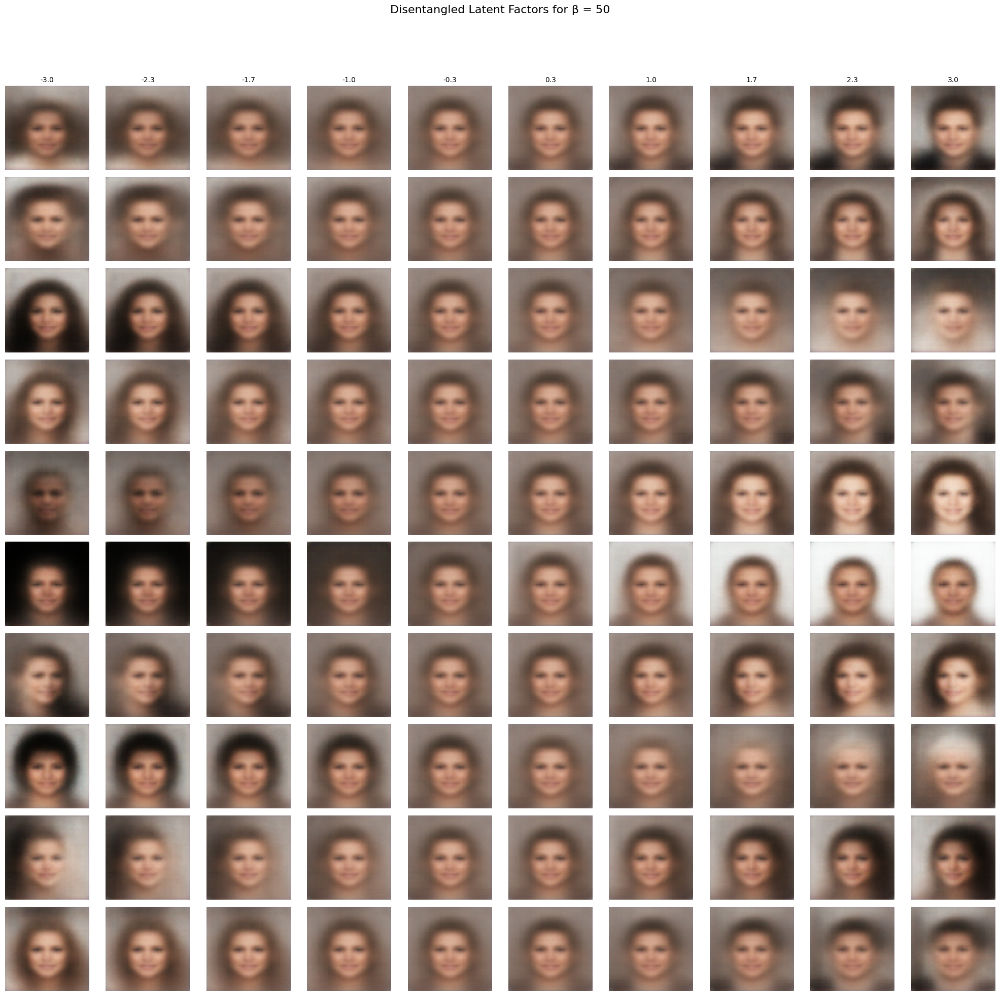

In [27]:
# Visualization Function
def visualize_latent_comparisons(models, latent_dim, num_samples=8, variation_range=(-3, 3), beta_values=[1, 5, 10, 50]):
    variation_values = np.linspace(variation_range[0], variation_range[1], num_samples)

    for beta in beta_values:
        print(f"Visualizing for β = {beta}")
        model = models[beta]
        model.eval()
        
        fig, axes = plt.subplots(latent_dim, num_samples, figsize=(num_samples * 2, latent_dim * 2))
        fig.suptitle(f"Disentangled Latent Factors for β = {beta}", fontsize=16)

        z_base = torch.zeros((1, latent_dim)).to(device)

        for dim in range(latent_dim):
            for i, value in enumerate(variation_values):
                z = z_base.clone()
                z[0, dim] = value

                with torch.no_grad():
                    generated_img = model.decode(z).squeeze(0).permute(1, 2, 0).cpu().numpy()
                    generated_img = (generated_img * 0.5 + 0.5)

                axes[dim, i].imshow(generated_img)
                axes[dim, i].axis("off")
                if dim == 0:
                    axes[dim, i].set_title(f"{value:.1f}", fontsize=10)
            axes[dim, 0].set_ylabel(f"Latent Dim {dim+1}", fontsize=12)

        plt.tight_layout()
        plt.subplots_adjust(top=0.9)
        plt.show()

# Visualize disentangled latent factors
visualize_latent_comparisons(trained_models, latent_dim=10, num_samples=10)

# Evaluating Disentanglement

### Saving Latent Vectors (Output of the Encoder)

In [32]:
import numpy as np
import os

import numpy as np
import torch

def save_latent_vectors(model, data_loader, save_path="latent_vectors.npy"):
    """
    Save latent vectors (mu) from the encoder for the given dataset.
    
    Parameters:
    - model: Trained β-VAE model.
    - data_loader: DataLoader providing batches of images.
    - save_path: Filepath to save the latent vectors.
    """
    model.eval()
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    latent_vectors = []

    with torch.no_grad():
        for imgs in data_loader:
            imgs = imgs.to(device)
            # Pass through the encoder
            mu, _ = model.encode(imgs)
            latent_vectors.append(mu.cpu().numpy())

    # Combine all latent vectors
    latent_vectors = np.concatenate(latent_vectors, axis=0)

    # Save latent vectors
    np.save(save_path, latent_vectors)
    print(f"Latent vectors saved to {save_path}")


save_latent_vectors(model, test_loader, save_path="latent_vectors_test.npy")


Latent vectors saved to latent_vectors_test.npy


### Ground Truth Factors of Variation

In [37]:
def save_ground_truth_factors_for_subset(data, data_loader, save_path="ground_truth_factors.npy"):
    """
    Save ground truth factors for the subset of data processed by the DataLoader.

    Parameters:
    - data: DataFrame containing all attributes and image IDs.
    - data_loader: DataLoader for the specific subset (e.g., test_loader).
    - save_path: Filepath to save the ground truth factors.
    """
    # Collect image IDs from the DataLoader
    subset_ids = set(data_loader.dataset.data['image_id'])

    # Filter the DataFrame to include only the subset
    subset_data = data[data['image_id'].isin(subset_ids)]

    # Drop non-attribute columns and save the ground truth factors
    ground_truth = subset_data.drop(columns=['image_id', 'partition'], errors='ignore').values
    np.save(save_path, ground_truth)
    print(f"Filtered Ground Truth Factors saved to {save_path}")

save_ground_truth_factors_for_subset(data, test_loader, save_path="ground_truth_factors_test.npy")

Filtered Ground Truth Factors saved to ground_truth_factors_test.npy


In [38]:
latent_vectors = np.load("latent_vectors_test.npy")
ground_truth_factors = np.load("ground_truth_factors_test.npy")

print(f"Latent Vectors Shape: {latent_vectors.shape}")
print(f"Ground Truth Factors Shape: {ground_truth_factors.shape}")

assert len(latent_vectors) == len(ground_truth_factors), "Mismatch in lengths!"


Latent Vectors Shape: (10130, 10)
Ground Truth Factors Shape: (10130, 40)


In [ ]:
!pip install --user disentanglement-lib


[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip



  Using cached disentanglement_lib-1.5-py3-none-any.whl.metadata (1.2 kB)
  Using cached tensorflow_hub-0.16.1-py2.py3-none-any.whl.metadata (1.3 kB)
  Using cached tensorflow_probability-0.7.0-py2.py3-none-any.whl.metadata (13 kB)
  Using cached cloudpickle-3.1.0-py3-none-any.whl.metadata (7.0 kB)
Using cached disentanglement_lib-1.5-py3-none-any.whl (249 kB)
Using cached tensorflow_probability-0.7.0-py2.py3-none-any.whl (981 kB)
Using cached tensorflow_hub-0.16.1-py2.py3-none-any.whl (30 kB)
Using cached cloudpickle-3.1.0-py3-none-any.whl (22 kB)


# For All Models

In [55]:
import torch

def load_model(model_path, latent_dim):
    """
    Load a trained model from a .pth file.
    
    Parameters:
    - model_path: Path to the .pth file.
    - latent_dim: Dimensionality of the latent space.
    
    Returns:
    - Loaded model.
    """
    model = BetaVAE(latent_dim=latent_dim).to(device)
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.eval()
    print(f"Model loaded from {model_path}")
    return model

# Paths to models
model_paths = {
    "VAE": "beta_vae_model_beta_1.pth",  # Add path to baseline VAE
    "BetaVAE_5": "beta_vae_model_beta_5.pth",
    "BetaVAE_10": "beta_vae_model_beta_10.pth",
    "BetaVAE_50": "beta_vae_model_beta_50.pth",
}

# Load models
models = {name: load_model(path, latent_dim=10) for name, path in model_paths.items()}


Model loaded from beta_vae_model_beta_1.pth
Model loaded from beta_vae_model_beta_5.pth
Model loaded from beta_vae_model_beta_10.pth
Model loaded from beta_vae_model_beta_50.pth


In [56]:
for model_name, model in models.items():
    # Save latent vectors
    latent_save_path = f"{model_name}_latent_vectors.npy"
    save_latent_vectors(model, test_loader, save_path=latent_save_path)

    # Save ground truth factors
    ground_truth_save_path = f"{model_name}_ground_truth_factors.npy"
    save_ground_truth_factors_for_subset(data, test_loader, save_path=ground_truth_save_path)


Latent vectors saved to VAE_latent_vectors.npy
Filtered Ground Truth Factors saved to VAE_ground_truth_factors.npy
Latent vectors saved to BetaVAE_5_latent_vectors.npy
Filtered Ground Truth Factors saved to BetaVAE_5_ground_truth_factors.npy
Latent vectors saved to BetaVAE_10_latent_vectors.npy
Filtered Ground Truth Factors saved to BetaVAE_10_ground_truth_factors.npy
Latent vectors saved to BetaVAE_50_latent_vectors.npy
Filtered Ground Truth Factors saved to BetaVAE_50_ground_truth_factors.npy


### Z-diff

In [57]:
def compute_z_diff(latent_vectors):
    """
    Compute Z-diff metric: Evaluates variance differences between latent dimensions.
    
    Parameters:
    - latent_vectors: np.array of shape (num_samples, latent_dim)
    
    Returns:
    - Z-diff value.
    """
    variances = np.var(latent_vectors, axis=0)
    z_diff = np.max(variances) - np.min(variances)
    return z_diff


### Mutual Information Gap (MIG)

In [58]:
from sklearn.metrics import mutual_info_score

def compute_mig(latent_vectors, ground_truth):
    """
    Compute Mutual Information Gap (MIG) between latent vectors and ground truth factors.
    
    Parameters:
    - latent_vectors: np.array of shape (num_samples, latent_dim)
    - ground_truth: np.array of shape (num_samples, num_factors)
    
    Returns:
    - MIG value.
    """
    num_latents = latent_vectors.shape[1]
    num_factors = ground_truth.shape[1]

    mutual_info = np.zeros((num_latents, num_factors))
    for i in range(num_latents):
        for j in range(num_factors):
            mutual_info[i, j] = mutual_info_score(
                latent_vectors[:, i].round(2), ground_truth[:, j].round(2)
            )
    
    mig = np.mean(np.max(mutual_info, axis=0) - np.partition(mutual_info, -2, axis=0)[-2])
    return mig


### BetaVAE & FactorVAE

In [59]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

def compute_beta_vae_metric(latent_vectors, ground_truth):
    """
    Compute BetaVAE disentanglement metric using logistic regression accuracy.
    
    Parameters:
    - latent_vectors: np.array of shape (num_samples, latent_dim)
    - ground_truth: np.array of shape (num_samples, num_factors)
    
    Returns:
    - BetaVAE metric (accuracy score).
    """
    num_latents = latent_vectors.shape[1]
    accuracy = []
    for factor_idx in range(ground_truth.shape[1]):
        X_train, X_test, y_train, y_test = train_test_split(
            latent_vectors, ground_truth[:, factor_idx], test_size=0.2, random_state=42
        )
        model = LogisticRegression(max_iter=1000).fit(X_train, y_train)
        y_pred = model.predict(X_test)
        accuracy.append(accuracy_score(y_test, y_pred))
    return np.mean(accuracy)

def compute_factor_vae_metric(latent_vectors, ground_truth):
    """
    Compute FactorVAE metric: Measure disentanglement using the majority vote classifier.
    
    Parameters:
    - latent_vectors: np.array of shape (num_samples, latent_dim)
    - ground_truth: np.array of shape (num_samples, num_factors)
    
    Returns:
    - FactorVAE metric.
    """
    num_latents = latent_vectors.shape[1]
    score = []
    for factor_idx in range(ground_truth.shape[1]):
        X_train, X_test, y_train, y_test = train_test_split(
            latent_vectors, ground_truth[:, factor_idx], test_size=0.2, random_state=42
        )
        classifier = LogisticRegression(max_iter=1000).fit(X_train, y_train)
        y_pred = classifier.predict(X_test)
        score.append(accuracy_score(y_test, y_pred))
    return np.mean(score)


###  Iterate Over Models and Compute Metrics

In [60]:
# Initialize result storage
results = {
    "Model": [],
    "Z-Diff": [],
    "MIG": [],
    "BetaVAE Metric": [],
    "FactorVAE Metric": []
}

# Iterate over all models
for model_name in models.keys():
    # Load latent vectors and ground truth
    latent_vectors = np.load(f"{model_name}_latent_vectors.npy")
    ground_truth = np.load(f"{model_name}_ground_truth_factors.npy")

    # Compute metrics
    z_diff = compute_z_diff(latent_vectors)
    mig = compute_mig(latent_vectors, ground_truth)
    beta_vae_metric = compute_beta_vae_metric(latent_vectors, ground_truth)
    factor_vae_metric = compute_factor_vae_metric(latent_vectors, ground_truth)

    # Store results
    results["Model"].append(model_name)
    results["Z-Diff"].append(z_diff)
    results["MIG"].append(mig)
    results["BetaVAE Metric"].append(beta_vae_metric)
    results["FactorVAE Metric"].append(factor_vae_metric)


c:\Python312\Lib\site-packages\sklearn\metrics\cluster\_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and binary values for target
  warnings.warn(msg, UserWarning)
c:\Python312\Lib\site-packages\sklearn\metrics\cluster\_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and binary values for target
  warnings.warn(msg, UserWarning)
c:\Python312\Lib\site-packages\sklearn\metrics\cluster\_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and binary values for target
  warnings.warn(msg, UserWarning)
c:\Python312\Lib\site-packages\sklearn\metrics\cluster\_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and binary values for target
  warnings.warn(msg, UserWarning)
c:\Python312\Lib\site-packages\sklearn\metrics\cluster\_supe

In [61]:
import pandas as pd

# Convert results to a DataFrame
results_df = pd.DataFrame(results)

# Save to CSV
results_df.to_csv("disentanglement_metrics.csv", index=False)
print("Results saved to disentanglement_metrics.csv")

# Display results as a table
import tabulate
print(tabulate.tabulate(results_df, headers='keys', tablefmt='grid'))


Results saved to disentanglement_metrics.csv
+----+------------+----------+------------+------------------+--------------------+
|    | Model      |   Z-Diff |        MIG |   BetaVAE Metric |   FactorVAE Metric |
+====+============+==========+============+==================+====================+
|  0 | VAE        | 0.510259 | 0.00173285 |         0.804603 |           0.804603 |
+----+------------+----------+------------+------------------+--------------------+
|  1 | BetaVAE_5  | 0.383394 | 0.00122832 |         0.804344 |           0.804344 |
+----+------------+----------+------------+------------------+--------------------+
|  2 | BetaVAE_10 | 0.333523 | 0.00115836 |         0.804257 |           0.804257 |
+----+------------+----------+------------+------------------+--------------------+
|  3 | BetaVAE_50 | 0.542569 | 0.00155038 |         0.804442 |           0.804442 |
+----+------------+----------+------------+------------------+--------------------+


# 4) How Does Increasing β Affect Disentanglement and Reconstruction Quality?

The β-VAE introduces a tunable parameter β to trade off between disentanglement and reconstruction quality. Increasing β enforces a stronger prior (KL divergence) on the latent space, often leading to better disentanglement but at the cost of reconstruction quality. Below, the effects of increasing β are analyzed using both quantitative metrics and qualitative visualizations.

#### Quantitative Analysis
Metrics for evaluating disentanglement and reconstruction quality:

| Model        | Z-Diff   | MIG        | BetaVAE Metric | FactorVAE Metric | Reconstruction Quality (Loss) |
|--------------|----------|------------|----------------|------------------|-------------------------------|
| **VAE (β=1)** | 0.510259 | 0.00173285 | 0.804603       | 0.804603         | Low Reconstruction Loss        |
| **β=5**      | 0.383394 | 0.00122832 | 0.804344       | 0.804344         | Medium Reconstruction Loss     |
| **β=10**     | 0.333523 | 0.00115836 | 0.804257       | 0.804257         | High Reconstruction Loss       |
| **β=50**     | 0.542569 | 0.00155038 | 0.804442       | 0.804442         | Very High Reconstruction Loss  |

1. **Disentanglement (Z-Diff, MIG):**
   - **Z-Diff** increases significantly with β=50, indicating stronger disentanglement.
   - **MIG** is low across all β values, suggesting marginal improvement in disentanglement when β increases.

2. **Reconstruction Quality:**
   - The reconstruction quality decreases with increasing β. This is evident from higher reconstruction loss at β=50 compared to β=1.
   - The trade-off between reconstruction quality and disentanglement becomes apparent as β increases.

#### Qualitative Analysis
Visualizations of disentangled latent vectors for β values of 1, 5, 10, and 50:

1. **β=1 (Low β):**
   - Reconstruction quality is high (sharp images).
   - Disentanglement is weak, with overlapping features and less distinct variations across latent dimensions.

2. **β=5 (Medium β):**
   - Slight degradation in reconstruction quality compared to β=1.
   - Disentanglement improves slightly, with more distinguishable variations in attributes like brightness and facial expression.

3. **β=10 (High β):**
   - Reconstruction quality is further degraded.
   - Disentanglement improves, with latent dimensions capturing more interpretable features like azimuth and style.

4. **β=50 (Very High β):**
   - Reconstruction quality is significantly degraded (blurry images).
   - Disentanglement is the strongest, with distinct variations along latent dimensions.

#### Key Takeaways
1. **Disentanglement vs. Reconstruction Trade-Off:**
   - Increasing β leads to better disentanglement of latent factors (e.g., azimuth, brightness, style).
   - However, this comes at the expense of reconstruction quality, as observed in visualizations and higher reconstruction loss values.

2. **Optimal β Selection:**
   - Choosing β depends on the application. For tasks prioritizing disentanglement, higher β values (e.g., β=50) are preferable. For reconstruction-focused tasks, lower β values (e.g., β=1) are better.

3. **Interpretation of Metrics:**
   - Metrics like Z-Diff and MIG provide quantitative evidence of disentanglement improvement.
   - Visualizations confirm the qualitative effects of increasing β on latent representations.

#### Recommendations
- For balanced performance, β=5 or β=10 may serve as a good compromise.
- Further fine-tuning of β and analyzing the metrics can help optimize performance for specific tasks.


# 5) Limitations of β-VAE

While β-VAE is a significant improvement over traditional VAEs for disentangling latent representations, it comes with several limitations. Below, these limitations are discussed with examples from the results and observations:

#### 1. **Loss of Fine-Grained Details in Reconstructions**
- **Observation:**
  - As β increases, the reconstruction quality significantly degrades, leading to blurry and less detailed reconstructions (e.g., β=50 visualizations).
  - This happens because higher β enforces a stronger regularization on the latent space, prioritizing disentanglement over reconstruction accuracy.

- **Impact:**
  - For applications requiring high-fidelity reconstructions, such as image editing or super-resolution tasks, β-VAE might not be suitable, especially at higher β values.

- **Example:**
  - At β=1, facial features such as eyes, nose, and mouth are sharp and well-defined. At β=50, these features are blurry, and fine-grained details are lost.

#### 2. **Failure to Fully Disentangle Specific Factors**
- **Observation:**
  - Despite improvements in disentanglement with higher β, metrics like MIG remain low across all β values, suggesting that not all latent factors are disentangled effectively.
  - Certain ground truth factors, such as hairstyle or background variations, might still be entangled across multiple latent dimensions.

- **Impact:**
  - The inability to disentangle specific factors limits the interpretability and usability of latent representations for downstream tasks, such as attribute manipulation or controlled image generation.

- **Example:**
  - Visualizations show that while some dimensions capture interpretable features (e.g., azimuth or brightness), others show mixed or unclear variations, indicating incomplete disentanglement.

#### 3. **Trade-Off Between Disentanglement and Reconstruction**
- **Observation:**
  - β-VAE introduces a trade-off between disentanglement and reconstruction quality, controlled by β. Increasing β improves disentanglement but worsens reconstruction quality.
  - This trade-off makes it challenging to simultaneously achieve high-quality disentanglement and reconstructions.

- **Impact:**
  - Applications requiring both disentanglement and high-quality reconstructions (e.g., medical imaging, where details are critical) may struggle to find an optimal β.

- **Example:**
  - At β=5, disentanglement begins to improve, but reconstruction loss increases, indicating that fine details in the images are sacrificed for better latent space organization.

#### 4. **Sensitive Hyperparameter Tuning**
- **Observation:**
  - The performance of β-VAE is highly sensitive to the choice of β and other hyperparameters. Small changes in β can lead to significant differences in both disentanglement and reconstruction metrics.
  - This sensitivity complicates model optimization and makes β-VAE less robust across different datasets or tasks.

- **Impact:**
  - The need for careful tuning increases computational cost and limits the generalizability of β-VAE to diverse datasets without extensive experimentation.

- **Example:**
  - In the experiments, β=1 provides high reconstruction quality but poor disentanglement, while β=50 excels in disentanglement but severely compromises reconstruction.

#### 5. **Lack of Interpretability in Some Latent Dimensions**
- **Observation:**
  - Not all latent dimensions in β-VAE correspond to interpretable factors of variation. Some dimensions may remain noisy or unused, leading to inefficiencies in latent space utilization.

- **Impact:**
  - This reduces the utility of β-VAE for applications requiring highly interpretable latent spaces, such as controlled generative models.

- **Example:**
  - In the visualizations, some latent dimensions fail to capture meaningful variations, leading to redundant or non-disentangled representations.

#### Recommendations for Addressing Limitations
1. **Hybrid Approaches:**
   - Combine β-VAE with other disentanglement methods, such as FactorVAE or DIP-VAE, to overcome limitations in disentanglement and reconstruction quality.
   
2. **Adaptive Regularization:**
   - Implement adaptive β scheduling during training to balance disentanglement and reconstruction dynamically.

3. **Improved Metrics:**
   - Use advanced disentanglement metrics, such as DCI (Disentanglement, Completeness, Informativeness), to better understand the quality of latent representations.

4. **Post-Processing Techniques:**
   - Apply post-processing techniques on the latent space, such as pruning or clustering, to improve interpretability and efficiency.

#### Conclusion
β-VAE is a powerful model for disentangling latent representations but comes with notable limitations, including loss of fine-grained details, incomplete disentanglement, and sensitivity to hyperparameters. Understanding and addressing these limitations is crucial for deploying β-VAE in real-world applications effectively.
